In [1]:
import numpy as np
import pandas as pd
from animate_path import animate_path
import matplotlib.pyplot as plt
from matplotlib import animation, rc
from IPython.display import HTML
from TKM import TKM
from perform_clustering import read_data, perform_clustering, k_means, dbscan
import os
from sklearn.metrics.cluster import adjusted_mutual_info_score


In [2]:
# f = open('dataset_sizes', "w")
# f.write('filename, data size \n\n')
# for filename in os.listdir("full_data/"):
#     if filename.endswith(".csv"):
#         print(filename)
#         data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = 0, max_size = 600000000)

#         if tkm_data is not None:
#             t,m,n = tkm_data.shape
#             data_size = t*n
#             f.write(filename + ", %f \n\n" %(data_size))
#             t,m,n = tkm_data.shape
                        
# f.close()

In [3]:
import pandas as pd
table = pd.read_csv('dataset_sizes')
table.head()


,filename,data size
0,couzin_1800_10.csv,45000.0
1,couzin_3000_17.csv,114000.0
2,calovi_600_52.csv,56400.0
3,calovi_2100_62.csv,174300.0
4,reynolds_3500_83.csv,199500.0


In [4]:
sizes = [3000,6000, 10000]
for ind in range(len(sizes)-1):
    min_size = sizes[ind]
    max_size = sizes[ind+1]
    lam_val = 100
    lam = lam_val/100
    max_iterations = 5000
    
    table_min_max = table[(table[' data size ']>=min_size) & (table[' data size ']<max_size)]
    
    tot_entries = len(table_min_max)

    f = open("temp_log_%d_%d_%d_%d.txt" %(min_size, max_size, lam_val, max_iterations), "w")
    
    entry_count = 0
    
    ami_list = []
    tot_ami_list = []
    runtime_list = []

    for filename in table_min_max['filename']:
        entry_count +=1 
        data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = min_size, max_size = max_size)

        if tkm_data is not None:
            ami, tot_ami, runtime, weights = perform_clustering(tkm_data, true_labels, lam=lam, max_iter=max_iterations)
            ami_list.append(ami)
            tot_ami_list.append(tot_ami)
            runtime_list.append(runtime)


#             f.write(filename, ' ami: ', ami, ' total_ami: ', tot_ami, '\n\n')
            f.write(filename + ' ami: %f total_ami: %f runtime: %f \n\n' %(ami, tot_ami, runtime))
            t,m,n = tkm_data.shape
            print('t', t, n)
            print(entry_count, '/', tot_entries, ' running average', np.average(ami_list), np.average(tot_ami_list), np.average(runtime_list), '\n')



        else:
            continue

    ami_average = np.average(ami_list)
    tot_ami_average = np.average(tot_ami_list)
    runtime_average = np.average(runtime_list)

    f.write('ami average: %f total ami average: %f average runtime: %f' %(ami_average, tot_ami_average, runtime_average))
    f.close()

/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


KeyboardInterrupt: 

In [4]:
filename = 'calovi_600_52.csv' #'full_data/reynolds_900_3.csv' #table_min_max['filename'].to_list() 
data = pd.read_csv('full_data/'+filename)
min_size = 800
max_size = 3000

clustering_data = None
true_labels = None


dataset_size = data['id'].nunique()*data['frame'].nunique()

if dataset_size in range(min_size, max_size):
    data['x'] = (data['x'] - data['x'].min()) / (data['x'].max() - data['x'].min())
    data['y'] = (data['y'] - data['y'].min()) / (data['y'].max() - data['y'].min())

    frame_positions = []

    for frame in data['frame'].unique():
        frame_data = data[data['frame'] == frame]

        n_id = frame_data['id'].nunique()

        frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()

        frame_data.sort_values(["id_cumcounts", "id"], inplace=True)

        frame_positions.append(frame_data[['x', 'y']].to_numpy()[:n_id])

    true_labels = frame_data['cid'].to_list()[:n_id]

    try:
        clustering_data = np.transpose(np.array(frame_positions), axes=[0, 2, 1])

    except:
        print(csv_path, ' unable to be processed')



In [25]:
table_min_max = table[table[' data size ']<3000]

In [42]:
from TKM_long_term_clusters import *
from spectral_functions import * 
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_mutual_info_score

# filename = 'reynolds_100_94.csv' #'reynolds_100_40.csv'
# filename = table_min_max['filename'].to_list()[20] 

# table_min_max = table[(table[' data size ']>=800) & (table[' data size ']<3000)]
    
# tot_entries = len(table_min_max)


for filename in table_min_max['filename']:
    try: 
        data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = 800, max_size = 300000)
        t,m,n = tkm_data.shape

        if len(np.unique(true_labels)) > 2:
            ami, tot_ami, runtime, weights = perform_clustering(tkm_data, true_labels, lam=.80, max_iter=5000)


            print(ami, tot_ami)
            print(filename)

    # k = len(np.unique(true_labels))



    # pred_labels = find_final_labels(weights, k, all_labels=[], counts=[])
            assignments = np.argmax(weights, axis = 2).T
    except: 
        continue

1.0 0.7873840016397718
reynolds_100_57.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.45083978287889004
reynolds_100_56.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


1.0 0.07735861704949024
couzin_100_0.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.6706295828392371
reynolds_100_53.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.7198495703485572
reynolds_100_79.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


0.03135493521606282 0.16781009604853747
couzin_100_58.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.8947392868070962 0.5690361800161177
reynolds_100_50.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


1.0 0.9999999999999992
calovi_100_33.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.6921891207733842
reynolds_100_36.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.48168920676152116
calovi_100_55.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.2715780467879842
couzin_100_11.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.5306415325077007 0.09057864872776131
couzin_100_38.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.761830256325544 0.11982604421346423
couzin_100_23.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.9999999999999998 0.3270789532772551
reynolds_100_14.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


0.7955801882700849 0.903096773529915
calovi_100_73.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


0.4835587991489207 0.43137262143504745
couzin_100_31.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.5518358347640108
reynolds_100_39.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.8880412076753562 0.9178182198750473
calovi_100_66.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.7941713028913064 0.2024746248338399
reynolds_100_0.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.39156371833667136
reynolds_300_32.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


0.5290000630963217 0.32225209934352683
couzin_100_69.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


0.45064170810835075 0.16568448747612208
couzin_100_56.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


0.5980537609016249 0.3126105310832071
couzin_100_80.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0000000000000002 0.10064118981248565
couzin_100_50.csv


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.7198744163455308 0.18871094419026976
couzin_100_44.csv


In [129]:
filename = 'couzin_100_23.csv' #'reynolds_100_40.csv'

data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = 800, max_size = 300000)
t,m,n = tkm_data.shape
k = len(np.unique(true_labels))

tkm = TKM(tkm_data)
tkm.perform_clustering(k=k, lam = .80, max_iter = 10000)

if len(tkm.weights.shape) == 3:
    assignments = np.argmax(tkm.weights, axis=2).T
    t, n, k = tkm.weights.shape

elif len(tkm.weights.shape) == 2:
    assignments = tkm.weights
    n, t = tkm.weights.shape


pred_labels = find_final_label_sc(tkm.weights, k)
ami = adjusted_mutual_info_score(true_labels, pred_labels)
tot_ami = adjusted_mutual_info_score(np.tile(true_labels, t), (assignments.T).reshape(t * n))

# ami, tot_ami, runtime, weights = perform_clustering(tkm_data, true_labels, lam=.80, max_iter=20000)


print(ami, tot_ami)
assignments = np.argmax(tkm.weights, axis = 2).T

/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
0.761830256325544 0.10013787060770214


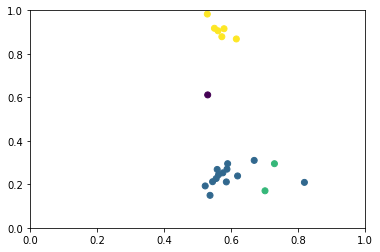

In [130]:
animate_path(tkm_data, np.tile(true_labels, t).reshape((t,n)).T, anim_frames = t, anim_interval = 100)

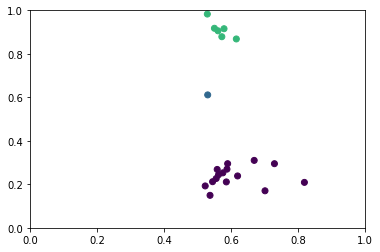

In [131]:
animate_path(tkm_data, assignments, anim_frames = t, anim_interval = 100)

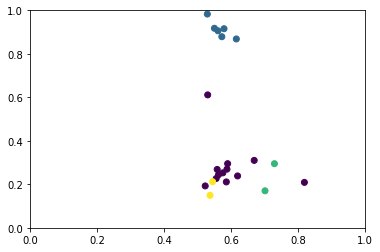

In [132]:
animate_path(tkm_data, np.tile(pred_labels, t).reshape((t,n)).T, anim_frames = t, anim_interval = 100)

In [72]:
# np.save('tkm_reynolds_300_71_weights', weights)
# np.save('tkm_reynolds_300_71_pred_labels', pred_labels)

In [6]:
# assignments = np.argmax(weights, axis = 2).T

# fig, axs = plt.subplots(1, k, figsize= (20,7))

# for label in np.unique(pred_labels):
#     members = np.where(pred_labels == label)[0]
#     clust_histories = assignments[members, :]
    
#     axs[int(label)].plot(clust_histories.T, '--o')
#     axs[int(label)].set_yticks(ticks = np.arange(k))
#     axs[int(label)].tick_params(axis = 'y', labelsize = 15)
#     axs[int(label)].tick_params(axis = 'x', labelsize = 15)
#     axs[int(label)].set_title('Cluster %d'%(int(label)), fontsize=20)

# fig.suptitle('Cluster Assignment Histories for Each Long-Term Cluster', fontsize = 25)
# fig.supxlabel('Time', fontsize = 20)
# fig.supylabel('Transient Cluster Membership', fontsize = 20)
# plt.tight_layout(rect=(0.025,0,1,1))
# plt.savefig('reynolds_300_71_histories.eps', format = 'eps')


    


In [12]:
filename = 'reynolds_600_25.csv'
data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = 800, max_size = 300000)
t,m,n = tkm_data.shape

/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


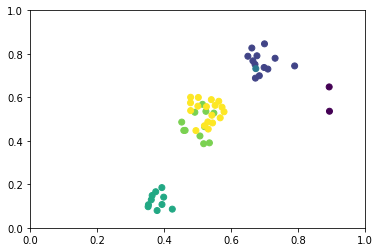

In [13]:
animate_path(tkm_data, np.tile(true_labels, t).reshape((t,n)).T, anim_frames = t, anim_interval = 100)

In [47]:
# animate_path(tkm_data, np.tile(pred_labels, t).reshape((t,n)).T, anim_frames = t, anim_interval = 150)

In [109]:
for filename in table[table[' data size ']<10000]['filename']:
    data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = 800, max_size = 300000)
    if len(np.unique(true_labels))==2:
        print(filename)
        


/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


couzin_100_6.csv
reynolds_1800_59.csv
calovi_100_22.csv
couzin_100_7.csv
calovi_600_47.csv
reynolds_300_10.csv
reynolds_100_80.csv
reynolds_100_94.csv
couzin_100_77.csv
reynolds_300_29.csv
calovi_100_19.csv
calovi_300_62.csv
couzin_1500_9.csv
couzin_600_17.csv
reynolds_900_9.csv
couzin_300_34.csv
calovi_100_30.csv
couzin_100_1.csv
reynolds_100_92.csv
calovi_300_75.csv
reynolds_100_51.csv
couzin_600_28.csv
couzin_100_70.csv
calovi_1200_8.csv
reynolds_100_78.csv


KeyboardInterrupt: 

In [10]:
filename = 'reynolds_900_3.csv'
data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = 800, max_size = 300000)
t,m,n = tkm_data.shape

k = len(np.unique(true_labels))


tkm = TKM(tkm_data)
tkm.perform_clustering(k=k, lam = .8, max_iter = 50000, dk = 1.001)
assignments = np.argmax(tkm.weights, axis = 2).T



/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


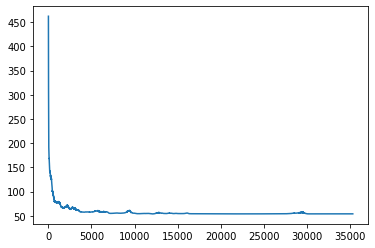

In [11]:
plt.plot(tkm.obj_hist[:])

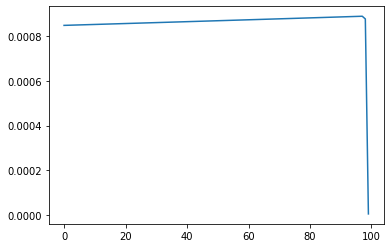

In [12]:
plt.plot(tkm.err_hist[-100:])


In [13]:
len(tkm.err_hist)

35345

In [14]:
tkm_plus_centers = np.dstack((tkm_data, tkm.centers))
extras = np.concatenate([np.ones((1,t))*i for i in range(k, 2*k)])
assignments_plus_centers = np.vstack((assignments, extras))

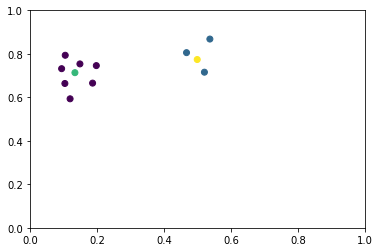

In [15]:
animate_path(tkm_plus_centers, assignments_plus_centers, anim_frames = t, anim_interval = 150)

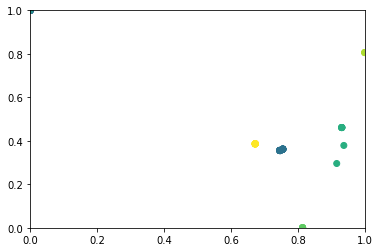

In [67]:
animate_path(tkm_data, assignments, anim_frames = t, anim_interval = 150)

In [21]:
# table[(table[' data size ']<=10000) & (table[' data size ']>=6000)]['filename'].values

In [51]:
from TKM_long_term_clusters import find_long_term_clusters, find_k_clusters, similarity_matrix

filename = 'reynolds_300_82.csv'#'couzin_100_48.csv'#'calovi_1200_33.csv'
data, tkm_data, true_labels = read_data('full_data/'+filename, min_size = 800, max_size = 300000)

k = data['cid'].nunique()
t,m,n = tkm_data.shape

# random_ind = np.random.randint(0,t, t//5)
# random_ind = np.sort(random_ind)


# partial_data = tkm_data[random_ind,:,:]

# t,m,n = partial_data.shape
tkm = TKM(tkm_data)
tkm.perform_clustering(k=k, lam=.80, max_iter=5000)
criteria_mat = similarity_matrix(tkm.weights)
ltc = find_k_clusters(k=k, criteria_mat=criteria_mat, threshold_change=.05)
pred_labels = np.zeros(n)

for i, cluster in enumerate(ltc):
    pred_labels[cluster] = i

ami = adjusted_mutual_info_score(true_labels, pred_labels)

assignments = np.argmax(tkm.weights, axis=2).T

tot_ami = adjusted_mutual_info_score(np.tile(true_labels, t), (assignments.T).reshape(t*n))

# ami, tot_ami, runtime, weights = perform_clustering(partial_data, true_labels, lam=5, max_iter=5000)

# assignments = np.argmax(tkm.weights, axis=2).T
print(ami, tot_ami)



/Users/olgadorabiala/Documents/Thesis/tkm/perform_clustering.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  frame_data["id_cumcounts"] = frame_data.groupby("id").cumcount()
/opt/anaconda3/envs/tkm/lib/python3.9/site-packages/pandas/util/_decorators.py:311: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Maximum number of iterations
1.0 0.15408485945705805


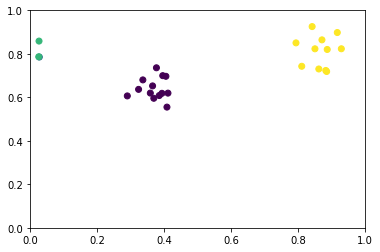

In [52]:
animate_path(tkm_data, np.tile(true_labels, t).reshape((t,n)).T, anim_frames = t, anim_interval = 150)

In [ ]:
animate_path(tkm_data, np.tile(pred_labels, t).reshape((t,n)).T, anim_frames = t, anim_interval = 150)

In [ ]:
animate_path(tkm_data, assignments, anim_frames = t, anim_interval = 150)

In [10]:
# assignments = np.argmax(weights, axis=2).T
# # print(t)
# # print(assignments.shape)

# def fill_out_predictions(assignments, t):
#     n, t_size = assignments.shape
#     new_assignments = np.zeros((n,t))
    
#     for j, row in enumerate(assignments):
#         for i, entry in enumerate(row[:-1]):
#             if row[i] == row[i+1]:
#                 print(entry)
#                 new_assignments[j, i*10:(i+1)*10] = entry
#                 print(new_assignments[j,:])
#             else:
#                 print('here')
#                 new_assignments[j, i*10:(i+1)*10//2] = entry
#                 new_assignments[j, (i+1)*10//2:(i+1)*10] = row[i+1]
#         print(row, '\n\n')        
#         print(new_assignments[j,:])
#     return new_assignments
            
# new_assignments = fill_out_predictions(assignments=assignments, t=t)

# print(len(true_labels), new_assignments.shape)

# # print('\n\n', new_assignments)

# tot_ami = adjusted_mutual_info_score(np.tile(true_labels,t), (new_assignments.T).reshape(t*n))
# print(tot_ami)

In [30]:
k = data['cid'].nunique()
t,m,n = tkm_data.shape
tkm = TKM(tkm_data)
# tkm.perform_clustering_center_derivative(k=k, lam = .60, gamma =.10, max_iter = 5000)
tkm.perform_clustering(k=k, lam = .60, max_iter = 5000)

from TKM_long_term_clusters import find_long_term_clusters, find_k_clusters, similarity_matrix

weights = np.transpose(tkm.weights, axes=[1,0,2])
np.random.shuffle(weights)
weights = np.transpose(weights, axes=[1,0,2])

criteria_mat = similarity_matrix(weights)

ltc = find_long_term_clusters(similarity_threshold = .70, criteria_mat=criteria_mat)

pred_labels = np.zeros(n)

for i, cluster in enumerate(ltc):
    pred_labels[cluster] = i

adjusted_mutual_info_score(true_labels, pred_labels)
# tot_ami = adjusted_mutual_info_score(np.tile(true_labels, len(t_subset)), (assignments.T).reshape(len(t_subset)*n))

print(ami)

1.0


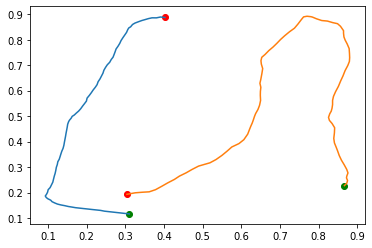

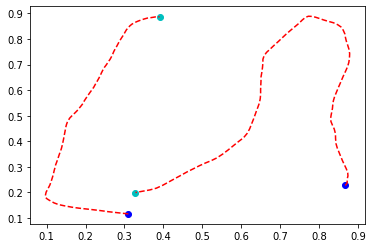

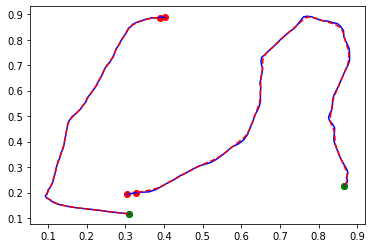

In [41]:
plt.figure()
for i in range(k):
    swarm_members = np.where(np.array(true_labels) == i)[0]
    swarm_mean = np.average(tkm_data[:,:, swarm_members], axis = 2)

    plt.scatter(swarm_mean[0,0], swarm_mean[0,1], c = 'g')
    plt.scatter(swarm_mean[-1,0], swarm_mean[-1,1], c = 'r')
    plt.plot(swarm_mean[:,0], swarm_mean[:,1], label = 'true')
    
plt.figure()
for j in range(k):
    plt.plot(tkm.centers[:, 0, j], tkm.centers[:,1,j], 'r--', label = 'predicted')
    plt.scatter(tkm.centers[0,0,j], tkm.centers[0,1,j], c = 'b')
    plt.scatter(tkm.centers[-1,0,j], tkm.centers[-1,1,j], c = 'c')
    
    
plt.figure()
for i in range(k):
    swarm_members = np.where(np.array(true_labels) == i)[0]
    swarm_mean = np.average(tkm_data[:,:, swarm_members], axis = 2)

    plt.scatter(swarm_mean[0,0], swarm_mean[0,1], c = 'g')
    plt.scatter(swarm_mean[-1,0], swarm_mean[-1,1], c = 'r')
    plt.plot(swarm_mean[:,0], swarm_mean[:,1], c = 'b', label = 'true')
    

for j in range(k):
    plt.plot(tkm.centers[:, 0, j], tkm.centers[:,1,j], 'r--', label = 'predicted')
    plt.scatter(tkm.centers[0,0,j], tkm.centers[0,1,j], c = 'g')
    plt.scatter(tkm.centers[-1,0,j], tkm.centers[-1,1,j], c = 'r')
    
    



In [7]:
from TKM_long_term_clusters import find_k_clusters, find_long_term_clusters, similarity_matrix

assignments = np.argmax(tkm.weights, axis = 2).T

sim_mat = similarity_matrix(assignments)

ltc = find_k_clusters(k=2, criteria_mat=sim_mat, threshold_change = .005, verbose=True)

# ltc = find_long_term_clusters(similarity_threshold = .67, criteria_mat = sim_mat)
print(ltc)

Threshold for  2  clusters:  0.7
[[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], [11, 12, 13, 14, 15, 16, 17, 18, 19, 20]]


In [100]:
pred_labels = np.zeros(n)

for i, cluster in enumerate(ltc):
    pred_labels[cluster] = i
    
# pred_labels = np.argmax(tkm.weights, axis = 1)

ami = adjusted_mutual_info_score(true_labels, pred_labels)

print(ami)

tot_ami = adjusted_mutual_info_score(np.tile(true_labels,t), (assignments.T).reshape(t*n) )

print(tot_ami)

-0.008292263623458382
0.11832288646896238


2022-02-01 12:51:45,040 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


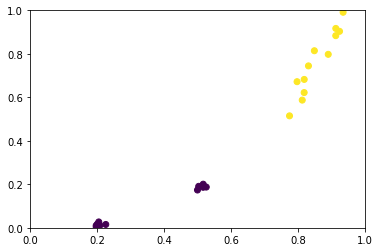

In [101]:
animate_path(tkm_data, assignments, anim_frames = t, anim_interval = 100)


In [ ]:
# ami over all time steps

adjusted_mutual_info_score(np.tile(true_labels, data['frame'].nunique()), (assignments.T).reshape(data['id'].nunique()*data['frame'].nunique()))



In [126]:
k

6